<a href="https://colab.research.google.com/github/RasyaAkbar/learning-pytorch-deeplearning/blob/main/07.%20Transfer%20Learning%20EffNet%20B0%20%2B%20Exercise%20(EffNet%20B2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 07. Transfer Learning

What is transfer learning?

Transfer learning involves taking the parameters of what one model has learned on another dataset and applying to our own problem.

* Pretrained model = foundation models

In [ ]:
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

# Try to get torchinfo, install it if not yet installed
try:
  from torchinfo import summary
except:
  print("[INFO] Couldn't find torchinfo... installing it.")
  !pip install -q torchinfo
  from torchinfo import summary

# Try to import the going_modular directory, download it from github if not work
try:
  from going_modular.exercise import data_setup, engine
except:
  # Get the going_modular scripts
  print("[INFO] Couldn't find going_modular scripts... downloading it from github")
  !git clone https://github.com/RasyaAkbar/learning-pytorch-deeplearning
  !mv learning-pytorch-deeplearning/going_modular .
  !rm -rf learning-pytorch-deeplearning
  from going_modular.exercise import data_setup, engine

[INFO] Couldn't find torchinfo... installing it.
[INFO] Couldn't find going_modular scripts... downloading it from github
Cloning into 'learning-pytorch-deeplearning'...
remote: Enumerating objects: 62, done.
remote: Counting objects: 100% (62/62), done.
remote: Compressing objects: 100% (61/61), done.
remote: Total 62 (delta 22), reused 2 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (62/62), 1.59 MiB | 10.78 MiB/s, done.
Resolving deltas: 100% (22/22), done.


In [ ]:
# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

## 1. Get data

In [ ]:
import os
import zipfile

from pathlib import Path

import requests

# Setup data path
data_path = Path("data/")
image_path = data_path / "pizza_steak_sushi"

# If image doesnt exist, download it
if image_path.is_dir():
  print(f"{image_path} exist...")
else:
  print(f"Couldnt find {image_path}, downloading it...")
  image_path.mkdir(parents=True, exist_ok=True)

  # Download pizza, steak, sushi data
  with open(data_path / "pizza_steak_sushi.zip", "wb")as f:
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip")
    print("Downloading pizza, steak, sushi data...")
    f.write(request.content)

  # unzip pizza, steak, sushi data
  with zipfile.ZipFile(data_path / "pizza_steak_sushi.zip", "r") as zip_ref:
    print("Unzipping pizza, steak, sushi data...")
    zip_ref.extractall(image_path)

  # Remove .zip file
  os.remove(data_path / "pizza_steak_sushi.zip")

Couldnt find data/pizza_steak_sushi, downloading it...
Unzipping pizza, steak, sushi data...


In [ ]:
# Setup directory path
train_dir = image_path/"train"
test_dir = image_path/"test"

train_dir, test_dir

(PosixPath('data/pizza_steak_sushi/train'),
 PosixPath('data/pizza_steak_sushi/test'))

## 2. Create Datasets and DataLoaders

Important point: when using a pretrained model, it's important that the data (including your custom data) that you pass through it is **transformed** in the same way that the data the model was trained on.

### 2.1 Creating a transform for `torchvision.models` (manual creating)

torchvision.models contains pretrained models (models ready for transfer learning) right within torchvision.

All pre-trained models expect input images normalized in the same way, i.e. mini-batches of 3-channel RGB images of shape (3 x H x W), where H and W are expected to be at least 224. The images have to be loaded in to a range of [0, 1] and then normalized using mean = [0.485, 0.456, 0.406] and std = [0.229, 0.224, 0.225]. You can use the following transform to normalize.

In [ ]:
from torchvision import transforms
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]
                                 )

manual_transforms = transforms.Compose([
  transforms.Resize((224, 224)),
  transforms.ToTensor(),
  normalize # make sure images have the same distribution as ImageNet (where our pretrained models have been trained)
])

In [ ]:
from going_modular.exercise import data_setup
train_dataloader, test_dataloader, class_names, test_data = data_setup.create_dataloaders(train_dir=train_dir,
                                                  test_dir=test_dir,
                                                  transform=manual_transforms,
                                                  batch_size=32)
train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x78337105b100>,
 ['pizza', 'steak', 'sushi'])

### 2.2 Creating a transform for `torchvision.models` (auto creation)

As of torchvision v0.13+ there is now support for automatic data transform creation based on the pretrained model weights you're using.

In [ ]:
import torchvision
torchvision.__version__

'0.19.1+cu121'

In [ ]:
# Get a set of pretrained model weights
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # "DEFAULT" = best available weights
weights

EfficientNet_B0_Weights.IMAGENET1K_V1

In [ ]:
# Get the transforms used to create our pretrained weights
auto_transforms = weights.transforms()
auto_transforms

ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

In [ ]:
# Create DataLoaders using automatic transforms
from going_modular.exercise import data_setup
train_dataloader, test_dataloader, class_names, test_data = data_setup.create_dataloaders(train_dir=train_dir,
                                                  test_dir=test_dir,
                                                  transform=auto_transforms,
                                                  batch_size=32)
train_dataloader, test_dataloader, class_names, len(test_data)

(<torch.utils.data.dataloader.DataLoader at 0x78343c73bd30>,
 ['pizza', 'steak', 'sushi'],
 75)

## 3. Getting a pretrained model

There are various places to get a pretrained model, such as:

1. PyTorch domain libraries
2. Libraries like timm (torch image models)
3. HuggingFace Hub (for plenty of different models)
4. Paperswithcode (for models across different problem spaces/domains)

### 3.1 Which pretrained model should you use?

The whole idea of transfer learning: take an already well-performing model from a problem space similar to your own and then customize to your own problem.

Three things to consider:

1. Speed - how fast does it need to run?
2. Size - how big is the model?
3. Performance - how well does it go on your chosen problem (e.g. how well does it classify food images? for FoodVision Mini)?

Where does the model live?

Is it on device? (like a self-driving car)

Or does it live on a server?

Looking at https://pytorch.org/vision/main/models.html#table-of-all-available-classification-weights

Which model should we chose?

For our case (deploying FoodVision Mini on a mobile device), it looks like EffNetB0 is one of our best options in terms performance vs size.

However, in light of The Bitter Lesson, if we had infinite compute, we'd likely pick the biggest model + most parameters + most general we could - http://www.incompleteideas.net/IncIdeas/BitterLesson.html

### 3.2 Setting up a pretrained model

we want to create an instance of pretrained EffNet80 -
https://pytorch.org/vision/main/models/generated/torchvision.models.efficientnet_b0.html#torchvision.models.EfficientNet_B0_Weights

In [ ]:
# OLD method of creating a pretrained model (prior to torchvision v0.13)
# model = torchvision.models.efficientnet_b0(pretrained=True)

# NEW method of creating a pretrained model (torchvision v0.13+)
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # "DEFAULT" = best available weights
model = torchvision.models.efficientnet_b0(weights=weights).to(device)
model

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 88.2MB/s]


EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [ ]:
model.classifier

Sequential(
  (0): Dropout(p=0.2, inplace=True)
  (1): Linear(in_features=1280, out_features=1000, bias=True)
)

### 3.3 Getting a summary of our model with `torchinfo.summary()`

In [ ]:
# Print with torchinfo
from torchinfo import summary

summary(model=model,
        input_size=(1, 3, 224, 224), # Example of [batch_size, color_channels, height, width]
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
        )

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [1, 3, 224, 224]     [1, 1000]            --                   True
├─Sequential (features)                                      [1, 3, 224, 224]     [1, 1280, 7, 7]      --                   True
│    └─Conv2dNormActivation (0)                              [1, 3, 224, 224]     [1, 32, 112, 112]    --                   True
│    │    └─Conv2d (0)                                       [1, 3, 224, 224]     [1, 32, 112, 112]    864                  True
│    │    └─BatchNorm2d (1)                                  [1, 32, 112, 112]    [1, 32, 112, 112]    64                   True
│    │    └─SiLU (2)                                         [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential (1)                                        [1, 32, 112, 112]    [1, 16, 112,

### 3.4 Freezing the base model and changing the output layer to suit our needs

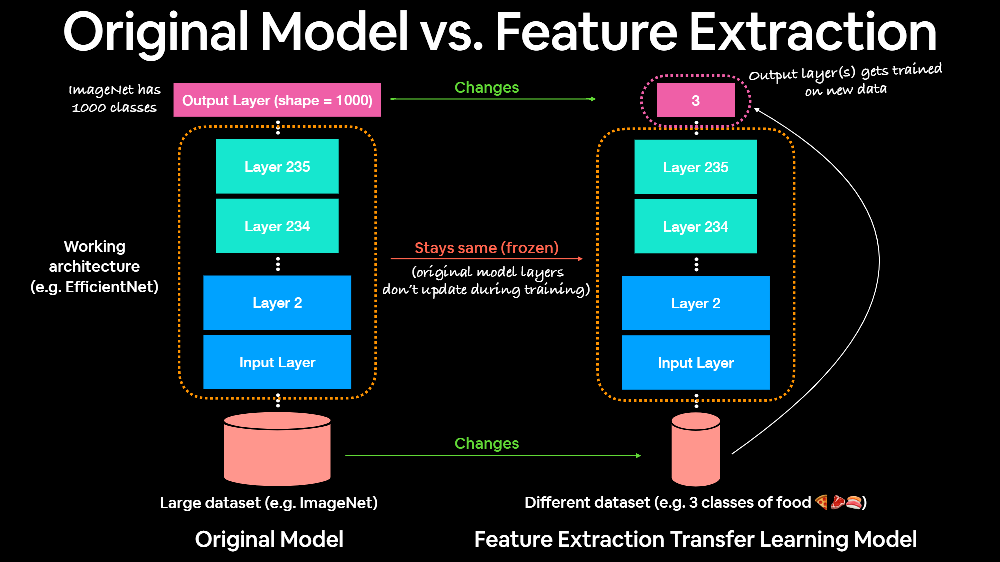

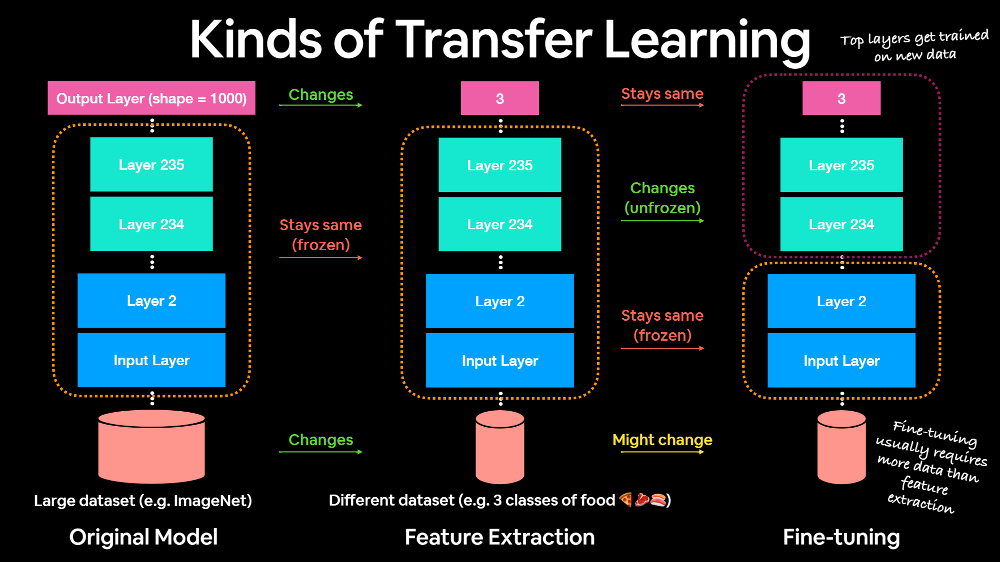

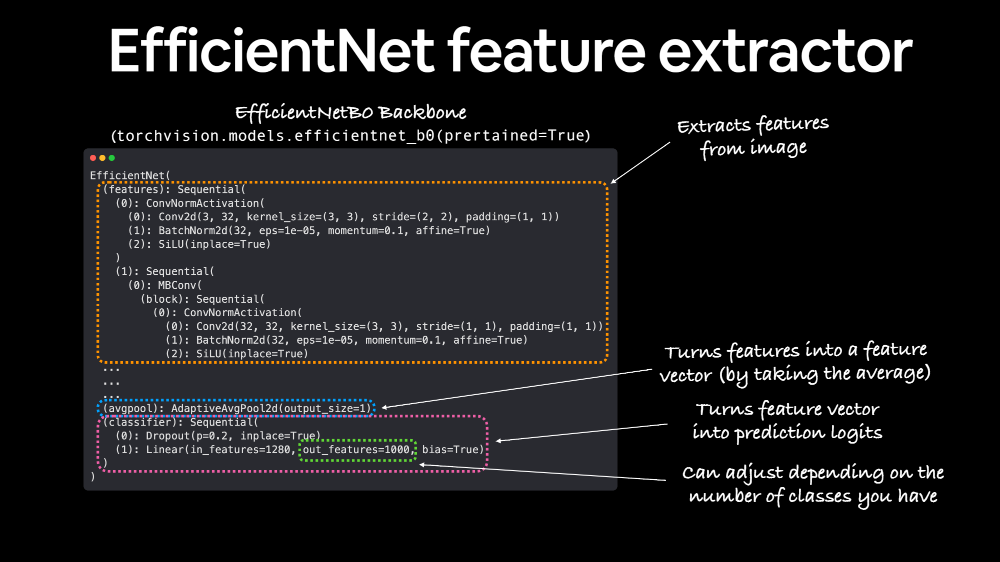

With a feature extractor model, typically you will "freeze" the base layer of a pretrained/foundation model and update the output layers to suit your own problem.

In [ ]:
# Freeze allof the base layers in EFFNet80
for param in model.features.parameters():
  #print(param)
  param.requires_grad = False

In [ ]:
len(class_names)

3

In [ ]:
# Update the classifier head of our modelto suit our problem
from torch import nn

torch.manual_seed(42)
torch.cuda.manual_seed(42)

model.classifier = nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
    nn.Linear(in_features=1280, # feature vector coming in
              out_features=len(class_names) # How many classes do we have
              )
).to(device)

In [ ]:
summary(model=model,
        input_size=(1, 3, 224, 224), # Example of [batch_size, color_channel, height, weight]
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
        )

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [1, 3, 224, 224]     [1, 3]               --                   Partial
├─Sequential (features)                                      [1, 3, 224, 224]     [1, 1280, 7, 7]      --                   False
│    └─Conv2dNormActivation (0)                              [1, 3, 224, 224]     [1, 32, 112, 112]    --                   False
│    │    └─Conv2d (0)                                       [1, 3, 224, 224]     [1, 32, 112, 112]    (864)                False
│    │    └─BatchNorm2d (1)                                  [1, 32, 112, 112]    [1, 32, 112, 112]    (64)                 False
│    │    └─SiLU (2)                                         [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential (1)                                        [1, 32, 112, 112]    [1, 1

## 4. Train model

In [ ]:
# Define loss and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [ ]:
# Import train function
from going_modular.exercise import engine

# Set manual seed
torch.manual_seed(42)
torch.cuda.manual_seed(42)

# Start the timer
from timeit import default_timer as timer
start_time = timer()

# Setup training and save the results
results = engine.train(model=model,
                       train_dataloader=train_dataloader,
                       test_dataloader=test_dataloader,
                       optimizer=optimizer,
                       loss_fn=loss_fn,
                       epochs=5,
                       device=device
                       )

# End the timer
end_time = timer()
print(f"[INFO] Total training time: {end_time-start_time:.3f} seconds")

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 0
-----

Train loss: 0.1974 , Train accuracy: 98.8281% 
Test loss: 0.3466, Test accuracy: 86.6477%

Epoch: 1
-----

Train loss: 0.1986 , Train accuracy: 98.0469% 
Test loss: 0.3524, Test accuracy: 87.6894%

Epoch: 2
-----

Train loss: 0.1780 , Train accuracy: 98.8281% 
Test loss: 0.3451, Test accuracy: 86.6477%

Epoch: 3
-----

Train loss: 0.1744 , Train accuracy: 99.6094% 
Test loss: 0.3283, Test accuracy: 88.7311%

Epoch: 4
-----

Train loss: 0.1631 , Train accuracy: 99.2188% 
Test loss: 0.3599, Test accuracy: 87.6894%

[INFO] Total training time: 167.760 seconds


## 5. Evaluate model by plotting loss curves

In [ ]:
try:
  from helper_functions import plot_loss_curves
except:
  print(f"[INFO] Couldn't find helper_functions.py, downloading one...")
  with open("helper_functions.py", "wb") as f:
    import requests
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/helper_functions.py")
    f.write(request.content)
  from helper_functions import plot_loss_curves

[INFO] Couldn't find helper_functions.py, downloading one...


In [ ]:
results

{'train_loss': [1.0965989083051682,
  0.9192043915390968,
  0.754199743270874,
  0.7377771064639091,
  0.626792136579752],
 'train_acc': [38.671875, 65.234375, 87.109375, 71.09375, 76.171875],
 'test_loss': [0.8842612306276957,
  0.7913958628972372,
  0.6483494242032369,
  0.5965305765469869,
  0.6126676797866821],
 'test_acc': [68.27651515151514,
  82.57575757575758,
  91.66666666666667,
  89.58333333333333,
  89.6780303030303]}

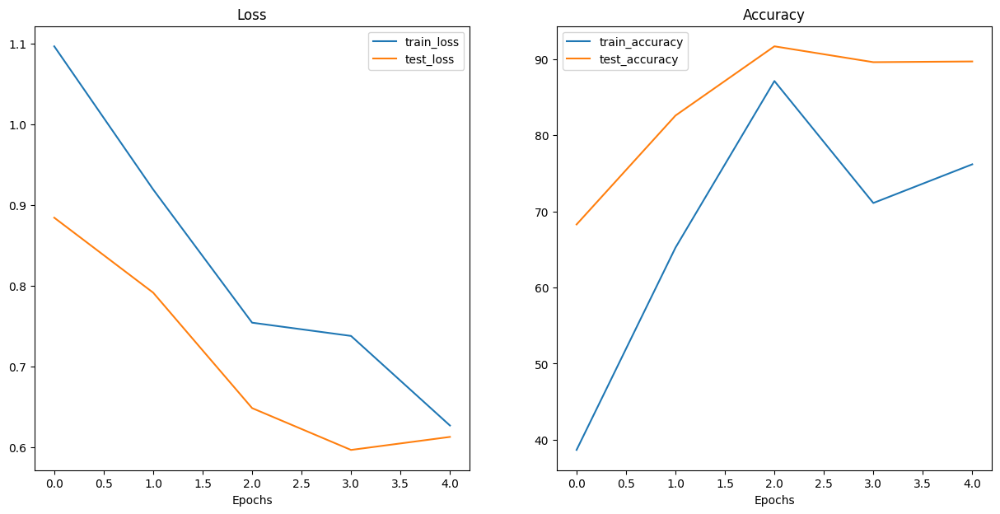

In [ ]:
  # Plot the loss curves of our model
plot_loss_curves(results)

## 6. Make Predictions on images from the test set

Some things to keep in mind when making predictions/inference on test data/custom data.

We have to make sure that our test/custom data is:

* Same shape - images need to be same shape as model was trained on
* Same datatype - custom data should be in the same data type
* Same device - custom data/test data should be on the same device as the model
* Same transform - if you've transformed your custom data, ideally you will transform the test data and custom data the same

In [ ]:
from typing import List, Tuple

from PIL import Image

from torchvision import transforms

# 1. Take in a trained model
def pred_and_plot_image(model: torch.nn.Module,
                        image_path: str,
                        class_names: List[str],
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None,
                        device: torch.device = device
                        ):
  # 2. Open the image with PIL
  img = Image.open(image_path)

  # 3. Create a transform if one doesnt exist
  if transform is not None:
    image_transform = transform
  else:
    image_transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225])
    ])

  ### Predict on image ###
  # 4. Make sure the model is on the target device
  model.to(device)

  # 5. Turn on inference mode and eval mode
  model.eval()
  with torch.inference_mode():
    # 6. Transform the image and add an extra batch dimension
    transformed_image = image_transform(img).unsqueeze(dim=0)

    # 7. Make a prediction on the transformed image by passing it to the model
    target_image_pred = model(transformed_image.to(device))

  # 8. Convert the model's output logits to pred probs
  target_image_pred_probs = torch.softmax(target_image_pred, dim=1)

  # 9. Convert the model's pred probs to pred labels
  target_image_pred_label = torch.argmax(target_image_pred_probs, dim=1)

  # 10. Plot image with predicted label and probability
  plt.figure()
  plt.imshow(img)
  plt.title(f"Pred: {class_names[target_image_pred_label]} | Confidence: {target_image_pred_probs.max()*100 : .3f}%")
  plt.axis(False)

In [ ]:
test_dir

PosixPath('data/pizza_steak_sushi/test')

In [ ]:
class_names

['pizza', 'steak', 'sushi']

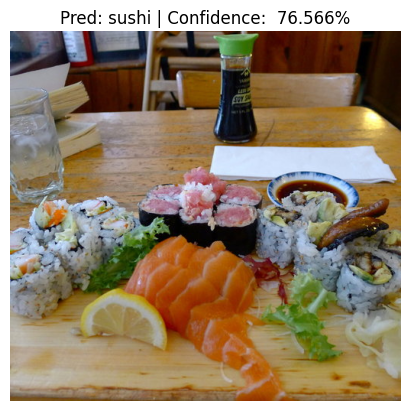

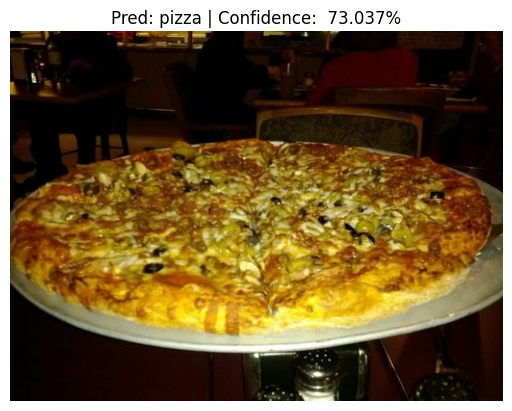

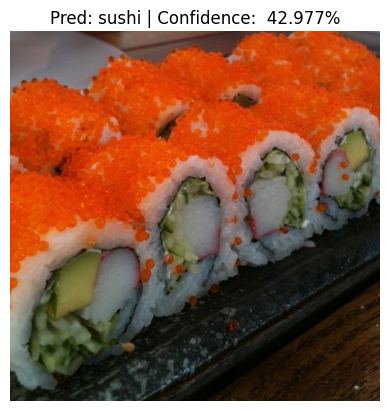

In [ ]:
# Get a random list of image paths from the test set
import random
num_images_to_plot = 3
test_image_path_list = list(Path(test_dir).glob("*/*.jpg"))
test_image_path_sample = random.sample(population=test_image_path_list,
                                       k=num_images_to_plot)

# Make predictions on and plot the images
for image_path in test_image_path_sample:
  pred_and_plot_image(model=model,
                      image_path=image_path,
                      class_names=class_names,
                      image_size=(224, 224)
                      )

### 6.1 Making predictions on a custom image

In [ ]:
# Download the image
import requests

# Setup custom image path
custom_image_path = data_path / "04-pizza-dad.jpg"

# Download the image if it doesn't exist
if not custom_image_path.is_file():
  with open(custom_image_path, "wb") as f:
    # Download image from github with "raw" link
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/images/04-pizza-dad.jpeg")
    print(f"Downloading {custom_image_path}...")
    f.write(request.content)
else:
  print(f"{custom_image_path} already exists")

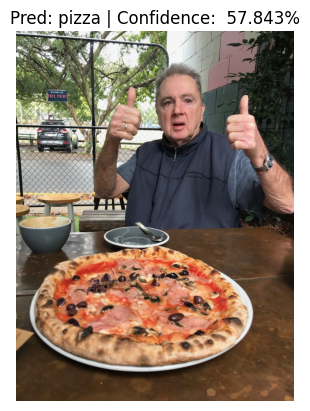

In [ ]:
# Predict on custom image
pred_and_plot_image(model=model,
                    image_path=custom_image_path,
                    class_names=class_names
                    )

In [ ]:
# See if required packages are installed if not install them
try:
  import torchmetrics, mlxtend
  print(f"mlxtend version: {mlxtend.__version__}")
  assert int(mlxtend.__version__.split(".")[1]>=19, "mlxtend version should be 0.19.0 or higher")
except:
  !pip install torchmetrics -U mlxtend
  import torchmetrics, mlxtend
  print(f"mlxtend version: {mlxtend.__version__}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 869.2/869.2 kB 39.1 MB/s eta 0:00:00
mlxtend version: 0.23.1


(tensor([[[-2.1179, -2.1008, -2.1008,  ..., -1.3987, -1.5185, -1.7069],
          [-2.1179, -2.1008, -2.1008,  ..., -1.3130, -1.4329, -1.6042],
          [-2.1179, -2.1008, -2.1008,  ..., -1.2617, -1.3815, -1.5528],
          ...,
          [-1.7412, -1.7412, -1.7412,  ..., -1.5014, -1.5014, -1.5185],
          [-1.7412, -1.7412, -1.7583,  ..., -1.5185, -1.5014, -1.5185],
          [-1.7583, -1.7412, -1.7583,  ..., -1.5014, -1.5185, -1.5528]],
 
         [[-2.0357, -2.0182, -2.0182,  ..., -1.9832, -1.9482, -1.9832],
          [-2.0357, -2.0182, -2.0182,  ..., -2.0182, -1.9832, -2.0007],
          [-2.0357, -2.0182, -2.0182,  ..., -2.0357, -2.0007, -1.9832],
          ...,
          [-1.9657, -1.9832, -1.9832,  ..., -1.9307, -1.9132, -1.9132],
          [-1.9657, -1.9832, -2.0007,  ..., -1.9482, -1.9132, -1.9132],
          [-1.9832, -1.9832, -2.0007,  ..., -1.9307, -1.9132, -1.9132]],
 
         [[-1.8044, -1.8044, -1.8044,  ..., -1.7347, -1.6999, -1.7347],
          [-1.8044, -1.8044,

In [ ]:

# Import tqdm.auto
from tqdm.auto import tqdm

# 1. Make predictions with trained model
y_preds = []
model.eval()
with torch.inference_mode():
  for X, y in tqdm(test_dataloader, desc="Making predictions..."):
    # Send the data and targets to target device
    X, y = X.to(device), y.to(device)
    # Do the forward pass
    y_logit = model(X)
    # Turn predictions from logits -> prediction probabilities -> prediction label
    y_pred = torch.softmax(y_logit.squeeze(), dim=0).argmax(dim=1)
    # Put prediction on CPU for evaluation (using matplotlib uses cpu)
    y_preds.append(y_pred.cpu())

# Concatenate list of predictions into a tensor
y_pred_tensor = torch.cat(y_preds)
len(y_pred_tensor)

Making predictions...:   0%|          | 0/3 [00:00<?, ?it/s]

75

In [ ]:
list(Path(test_dir).glob("*/*.jpg"))

75

<ipython-input-67-1a42b394052e>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


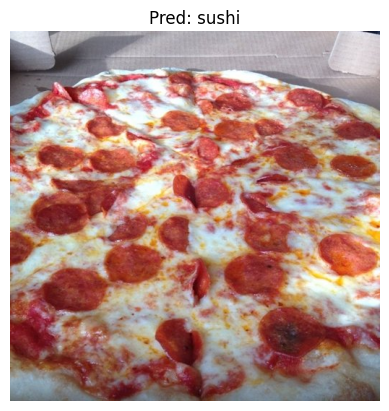

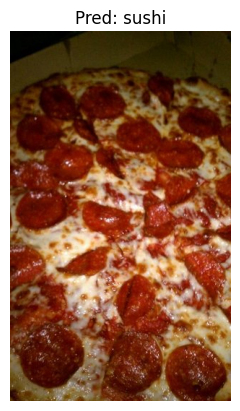

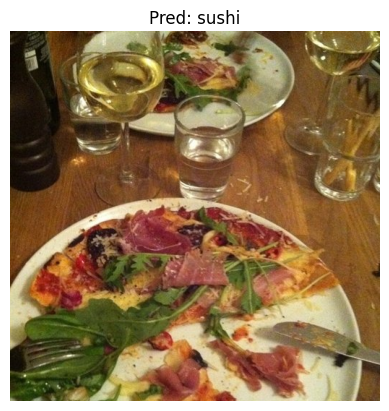

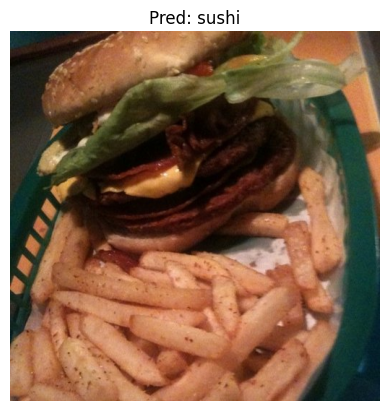

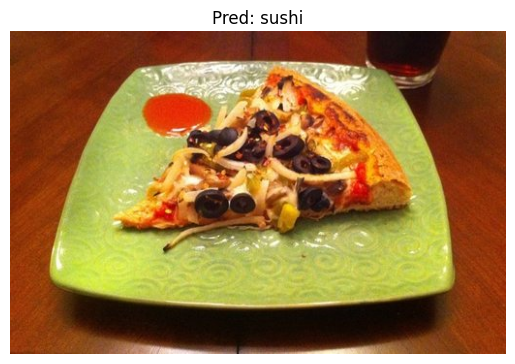

...

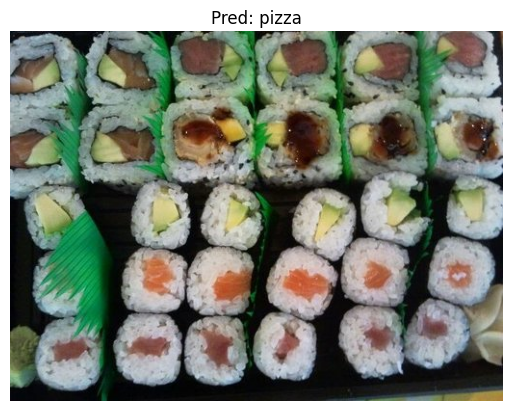

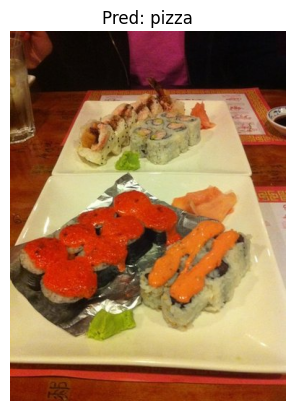

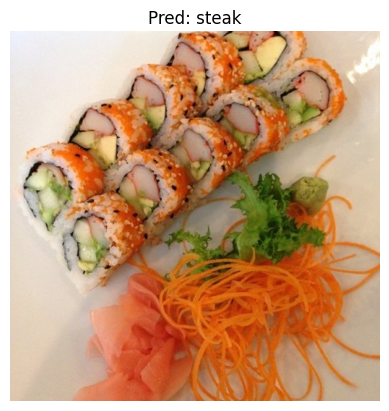

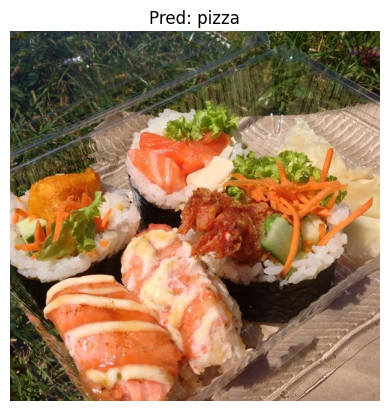

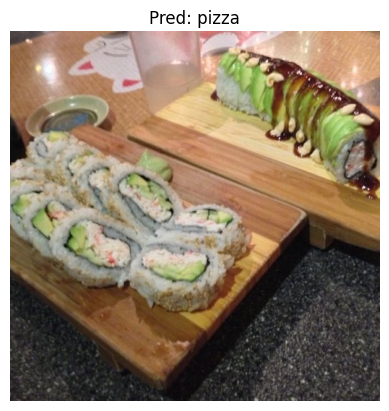

In [ ]:
wrong_pred = []
wrong_pred_label = []

for i in range(75):
  if y_pred_tensor[i] != test_data.targets[i]:
    wrong_pred.append(i)
    wrong_pred_label.append(y_pred_tensor[i])

images = list(Path(test_dir).glob("*/*.jpg"))
for i in wrong_pred[:]:
  img = Image.open(images[i])
  plt.figure()
  plt.imshow(img)
  plt.title(f"Pred: {class_names[y_pred_tensor[i]]}")
  plt.axis(False)

In [ ]:
(wrong_pred_label)

34

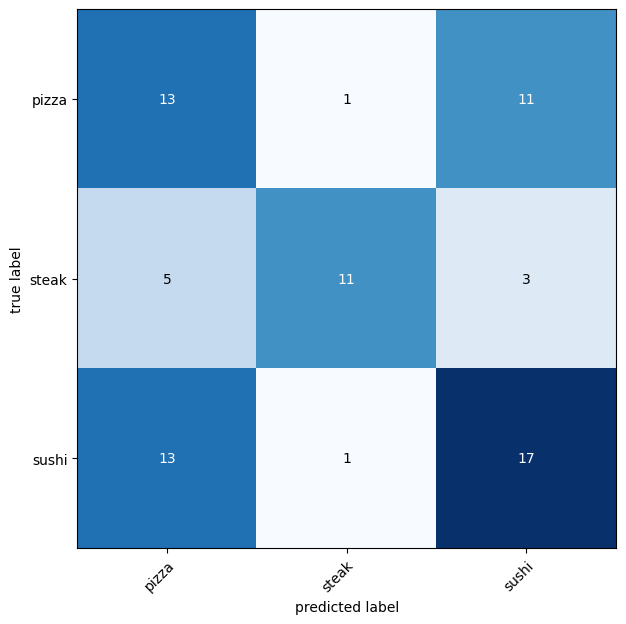

In [ ]:
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix
# importing library
import numpy as np

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=len(class_names), task="multiclass")
confmat_tensor = confmat(y_pred_tensor,
                         target=torch.tensor(test_data.targets) # some call it label instead of target
                         )

# 3. Plot the confusion matrix
fig, ax = plot_confusion_matrix(
    conf_mat=confmat_tensor.numpy(), # matplotlib love to work with numpy
    class_names = class_names,
    figsize=(10,7)
)

# Exercise

In [ ]:
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

# Try to get torchinfo, install it if not yet installed
try:
  from torchinfo import summary
except:
  print("[INFO] Couldn't find torchinfo... installing it.")
  !pip install -q torchinfo
  from torchinfo import summary

# Try to import the going_modular directory, download it from github if not work
try:
  from going_modular.exercise import data_setup, engine
except:
  # Get the going_modular scripts
  print("[INFO] Couldn't find going_modular scripts... downloading it from github")
  !git clone https://github.com/RasyaAkbar/learning-pytorch-deeplearning
  !mv learning-pytorch-deeplearning/going_modular .
  !rm -rf learning-pytorch-deeplearning
  from going_modular.exercise import data_setup, engine

[INFO] Couldn't find torchinfo... installing it.
[INFO] Couldn't find going_modular scripts... downloading it from github
Cloning into 'learning-pytorch-deeplearning'...
remote: Enumerating objects: 62, done.
remote: Counting objects: 100% (62/62), done.
remote: Compressing objects: 100% (61/61), done.
remote: Total 62 (delta 22), reused 2 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (62/62), 1.59 MiB | 9.41 MiB/s, done.
Resolving deltas: 100% (22/22), done.


In [ ]:
# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [ ]:
import os
import zipfile

from pathlib import Path

import requests

# Setup data path
data_path = Path("data/")
image_path = data_path / "pizza_steak_sushi"

# If image doesnt exist, download it
if image_path.is_dir():
  print(f"{image_path} exist...")
else:
  print(f"Couldnt find {image_path}, downloading it...")
  image_path.mkdir(parents=True, exist_ok=True)

  # Download pizza, steak, sushi data
  with open(data_path / "pizza_steak_sushi.zip", "wb")as f:
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip")
    print("Downloading pizza, steak, sushi data...")
    f.write(request.content)

  # unzip pizza, steak, sushi data
  with zipfile.ZipFile(data_path / "pizza_steak_sushi.zip", "r") as zip_ref:
    print("Unzipping pizza, steak, sushi data...")
    zip_ref.extractall(image_path)

  # Remove .zip file
  os.remove(data_path / "pizza_steak_sushi.zip")

Couldnt find data/pizza_steak_sushi, downloading it...
Unzipping pizza, steak, sushi data...


In [ ]:
# Setup directory path
train_dir = image_path/"train"
test_dir = image_path/"test"

train_dir, test_dir

(PosixPath('data/pizza_steak_sushi/train'),
 PosixPath('data/pizza_steak_sushi/test'))

In [ ]:
from going_modular.exercise import data_setup

# Get a set of pretrained model weights
weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # "DEFAULT" = best available weights

# Get the transforms used to create our pretrained weights
auto_transforms = weights.transforms()

# Create DataLoaders using automatic transforms
train_dataloader_ex, test_dataloader_ex, class_names_ex, test_data_ex = data_setup.create_dataloaders(train_dir=train_dir,
                                                  test_dir=test_dir,
                                                  transform=auto_transforms,
                                                  batch_size=32)

In [ ]:
model_ex = torchvision.models.efficientnet_b2(weights=weights).to(device)

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 75.0MB/s]


In [ ]:
# Print with torchinfo
from torchinfo import summary

summary(model=model_ex,
        input_size=(1, 3, 224, 224), # Example of [batch_size, color_channels, height, width]
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
        )

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [1, 3, 224, 224]     [1, 1000]            --                   True
├─Sequential (features)                                      [1, 3, 224, 224]     [1, 1408, 7, 7]      --                   True
│    └─Conv2dNormActivation (0)                              [1, 3, 224, 224]     [1, 32, 112, 112]    --                   True
│    │    └─Conv2d (0)                                       [1, 3, 224, 224]     [1, 32, 112, 112]    864                  True
│    │    └─BatchNorm2d (1)                                  [1, 32, 112, 112]    [1, 32, 112, 112]    64                   True
│    │    └─SiLU (2)                                         [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential (1)                                        [1, 32, 112, 112]    [1, 16, 112,

In [ ]:
# Freeze allof the base layers in EFFNet80
for param in model_ex.features.parameters():
  #print(param)
  param.requires_grad = False

In [ ]:
# Update the classifier head of our modelto suit our problem
from torch import nn

torch.manual_seed(42)
torch.cuda.manual_seed(42)

model_ex.classifier = nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
    nn.Linear(in_features=1408, # feature vector coming in
              out_features=len(class_names_ex) # How many classes do we have
              )
).to(device)

In [ ]:
# Define loss and optimizer
loss_fn_ex = nn.CrossEntropyLoss()
optimizer_ex = torch.optim.Adam(model_ex.parameters(), lr=0.001)

In [ ]:
# Import train function
from going_modular.exercise import engine

# Set manual seed
torch.manual_seed(42)
torch.cuda.manual_seed(42)

# Start the timer
from timeit import default_timer as timer
start_time = timer()

# Setup training and save the results
results_ex = engine.train(model=model_ex,
                       train_dataloader=train_dataloader_ex,
                       test_dataloader=test_dataloader_ex,
                       optimizer=optimizer_ex,
                       loss_fn=loss_fn_ex,
                       epochs=5,
                       device=device
                       )

# End the timer
end_time = timer()
print(f"[INFO] Total training time: {end_time-start_time:.3f} seconds")

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 0
-----

Train loss: 0.2330 , Train accuracy: 99.6094% 
Test loss: 0.4224, Test accuracy: 90.8144%

Epoch: 1
-----

Train loss: 0.2040 , Train accuracy: 99.2188% 
Test loss: 0.3978, Test accuracy: 88.7311%

Epoch: 2
-----

Train loss: 0.1953 , Train accuracy: 98.4375% 
Test loss: 0.3730, Test accuracy: 89.7727%

Epoch: 3
-----

Train loss: 0.2134 , Train accuracy: 98.8281% 
Test loss: 0.3416, Test accuracy: 89.7727%

Epoch: 4
-----

Train loss: 0.1976 , Train accuracy: 97.6562% 
Test loss: 0.3906, Test accuracy: 89.7727%

[INFO] Total training time: 16.016 seconds


In [ ]:
try:
  from helper_functions import plot_loss_curves
except:
  print(f"[INFO] Couldn't find helper_functions.py, downloading one...")
  with open("helper_functions.py", "wb") as f:
    import requests
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/helper_functions.py")
    f.write(request.content)
  from helper_functions import plot_loss_curves

[INFO] Couldn't find helper_functions.py, downloading one...


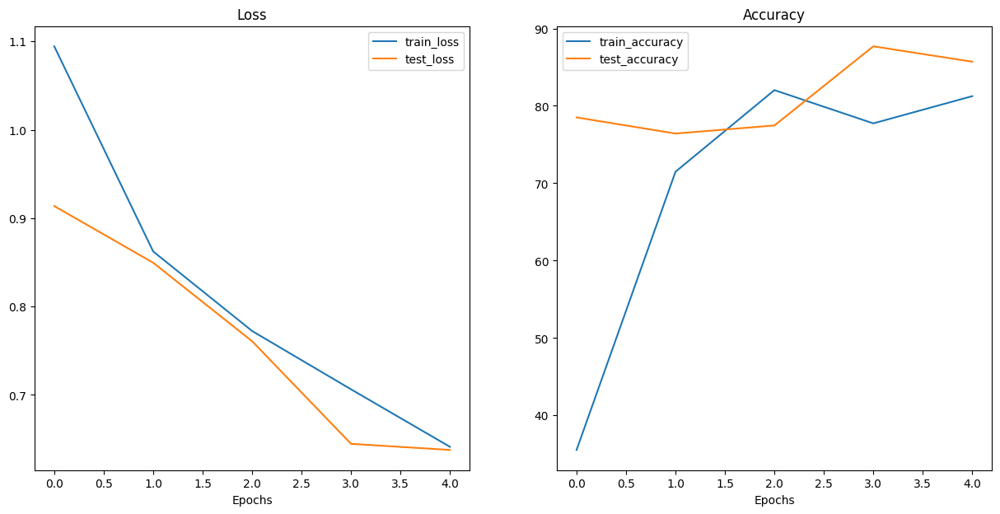

In [ ]:
  # Plot the loss curves of our model
plot_loss_curves(results_ex)

In [ ]:
# See if required packages are installed if not install them
try:
  import torchmetrics, mlxtend
  print(f"mlxtend version: {mlxtend.__version__}")
  assert int(mlxtend.__version__.split(".")[1]>=19, "mlxtend version should be 0.19.0 or higher")
except:
  !pip install torchmetrics -U mlxtend
  import torchmetrics, mlxtend
  print(f"mlxtend version: {mlxtend.__version__}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 869.2/869.2 kB 17.8 MB/s eta 0:00:00
mlxtend version: 0.23.1


In [ ]:
# Import tqdm.auto
from tqdm.auto import tqdm

# 1. Make predictions with trained model
y_preds_ex = []
model_ex.eval()
with torch.inference_mode():
  for X, y in tqdm(test_dataloader_ex, desc="Making predictions..."):
    # Send the data and targets to target device
    X, y = X.to(device), y.to(device)
    # Do the forward pass
    y_logit = model_ex(X)
    # Turn predictions from logits -> prediction probabilities -> prediction label
    y_pred = torch.softmax(y_logit.squeeze(), dim=0).argmax(dim=1)
    # Put prediction on CPU for evaluation (using matplotlib uses cpu)
    y_preds_ex.append(y_pred.cpu())

# Concatenate list of predictions into a tensor
y_pred_tensor_ex = torch.cat(y_preds_ex)
len(y_pred_tensor_ex)

Making predictions...:   0%|          | 0/3 [00:00<?, ?it/s]

75

<ipython-input-28-28e5d6be4081>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


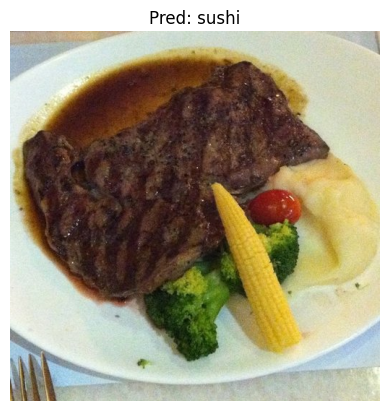

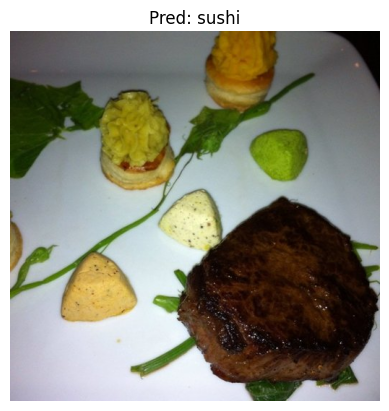

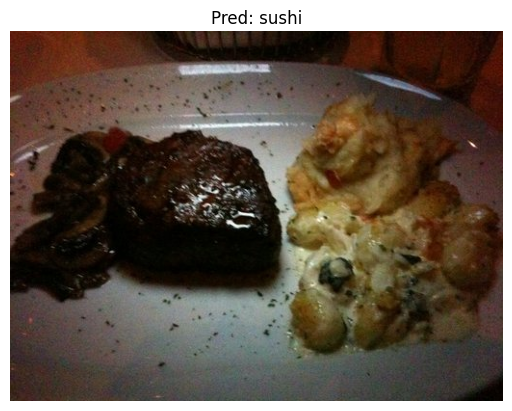

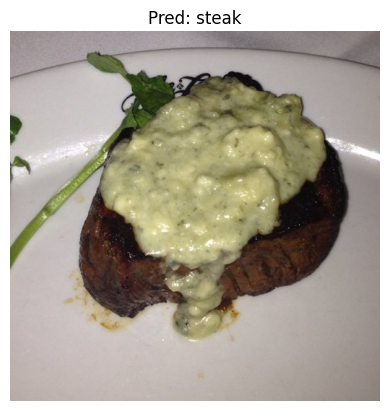

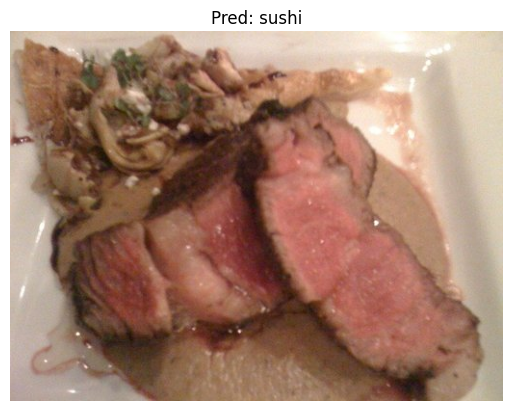

...

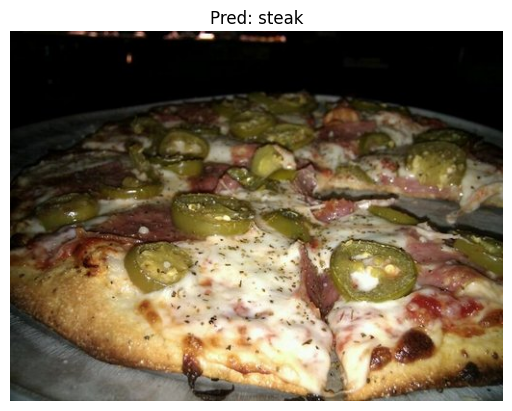

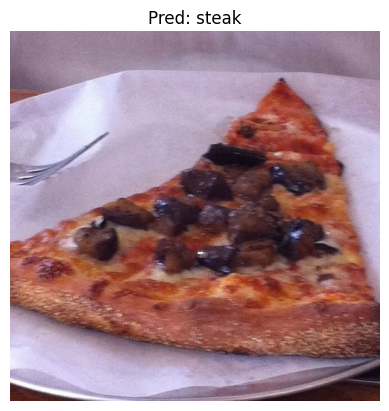

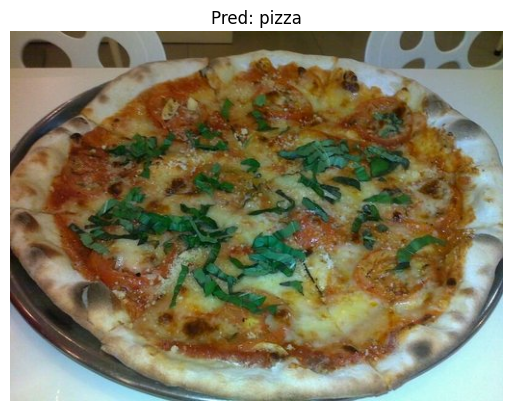

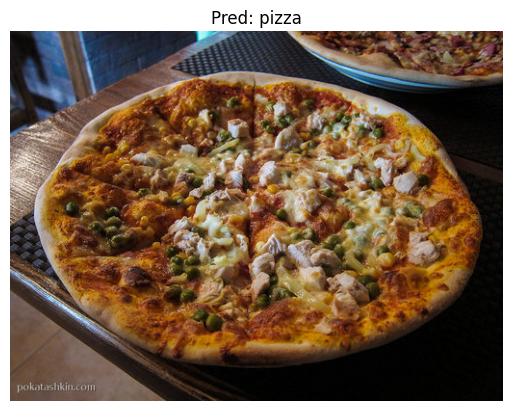

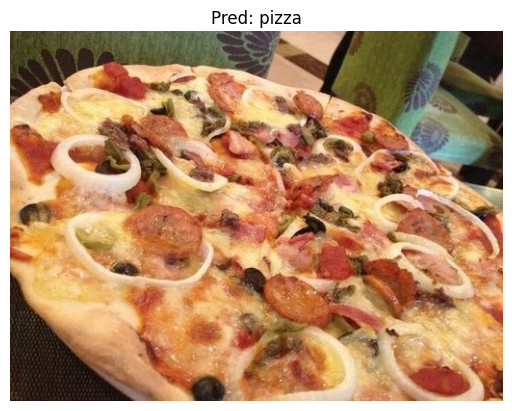

In [ ]:
from PIL import Image

wrong_pred_ex = []
wrong_pred_label_ex = []

for i in range(75):
  if y_pred_tensor_ex[i] != test_data_ex.targets[i]:
    wrong_pred_ex.append(i)
    wrong_pred_label_ex.append(y_pred_tensor_ex[i])

images = list(Path(test_dir).glob("*/*.jpg"))
for i in wrong_pred_ex[:]:
  img = Image.open(images[i])
  plt.figure()
  plt.imshow(img)
  plt.title(f"Pred: {class_names_ex[y_pred_tensor_ex[i]]}")
  plt.axis(False)

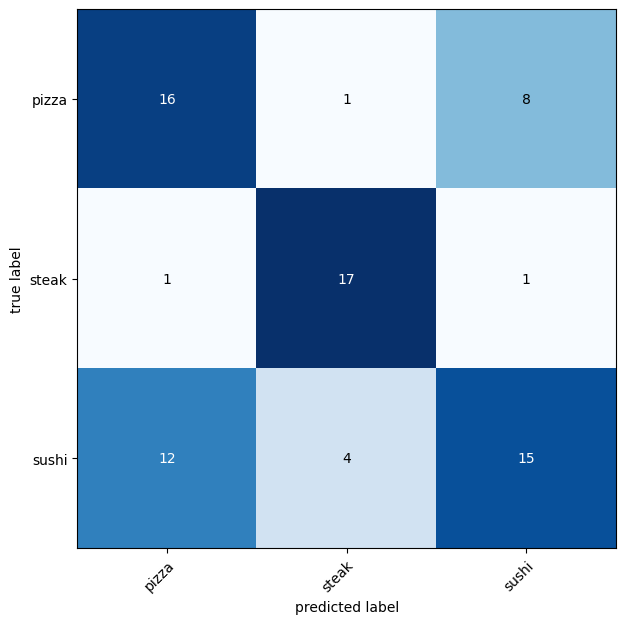

In [ ]:
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix
# importing library
import numpy as np

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=len(class_names_ex), task="multiclass")
confmat_tensor = confmat(y_pred_tensor_ex,
                         target=torch.tensor(test_data_ex.targets) # some call it label instead of target
                         )

# 3. Plot the confusion matrix
fig, ax = plot_confusion_matrix(
    conf_mat=confmat_tensor.numpy(), # matplotlib love to work with numpy
    class_names = class_names_ex,
    figsize=(10,7)
)